In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from yellowbrick.classifier import ROCAUC
from yellowbrick.classifier import ConfusionMatrix
from yellowbrick.classifier import ClassificationReport
pd.set_option('display.max_colwidth', -1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
np.random.seed(42)

/Users/seohohahm/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
df = pd.read_csv('household_national.csv')

In [23]:
df.head()

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,JACPRIMARY,JACSECNDRY,JADEQUACY,JBATHEXCLU,JBATHROOMS,JBEDROOMS,JBIKE,JBLD,JBUS,JCARPOOL,JCELLPHONE,JCOLD,JCOLDCOST,JCOLDEQ,JCOLDEQFREQ,JCOLDHTCAP,JCOLDINSUL,JCOLDOTHER,JCOLDUTIL,JCOMCOST,JCOMDAYS,JCOMPANYCAR,JCOMTYPE,JCONDO,JCOOKFUEL,JCOOKTYPE,JDBEVICLK,JDBEVICNOTE,JDBEVICTHT,JDBEVICWHERE,JDBFORCWHR,JDBLVEFORC,JDBMISSMORT,JDBMISSRENT,JDBUTBILL,JDINING,JDISHH,JDISHWASH,JDIST,JDPALTCOM,JDPDRFOOD,JDPEMWATER,JDPEVACPETS,JDPEVFIN,JDPEVINFO,JDPEVKIT,JDPEVLOC,JDPEVSEP,JDPEVVEHIC,JDPFLDINS,JDPGENERT,JDPGETINFO,JDPMAJDIS,JDPSHELTR,JDRIVEALL,JDRIVEPART,JDRYER,JDWNPAYPCT,JELECAMT,JENTRYSYS,JFERRY,JFINCP,JFINROOMS,JFIREPLACE,JFIRSTHOME,JFLOORHOLE,JFNDCRUMB,JFOUNDTYPE,JFRIDGE,JFS,JFUSEBLOW,JGARAGE,JGASAMT,JGRANDHH,JGUTREHB,JHEATFUEL,JHEATTYPE,JHHADLTKIDS,JHHAGE,JHHCARE,JHHCITSHP,JHHENROLL,JHHERRND,JHHGRAD,JHHHEAR,JHHINUSYR,JHHMAR,JHHMEMRY,JHHMOVE,JHHNATVTY,JHHOLDKIDS,JHHRACE,JHHRACEAS,JHHRACEPI,JHHSEE,JHHSEX,JHHSPAN,JHHWALK,JHHYNGKIDS,JHINCP,JHMRACCESS,JHMRENEFF,JHMRSALE,JHOA,JHOAAMT,JHOTWATER,JHOWBUY,JHRATE,JHSHLDTYPE,JHUDSUB,JINSURAMT,JKITCHENS,JKITCHSINK,JKITEXCLU,JLAUNDY,JLEADINSP,JLEAKI,JLEAKIDK,JLEAKIOTH,JLEAKIPIPE,JLEAKIPLUM,JLEAKIWATH,JLEAKO,JLEAKOBASE,JLEAKOOTH,JLEAKOROOF,JLEAKOWALL,JLOTAMT,JLOTSIZE,JMAINTAMT,JMARKETVAL,JMGRONSITE,JMHANCHOR,JMHMOVE,JMHWIDE,JMILHH,JMOLDBASEM,JMOLDBATH,JMOLDBEDRM,JMOLDKITCH,JMOLDLROOM,JMOLDOTHER,JMONLSTOCC,JMONOXIDE,JMORTAMT,JMOVFORCE,JMOVWHY,JMULTIGEN,JMVG1COST,JMVG1LOC,JMVG1PER,JMVG1STAT,JMVG1TEN,JMVG1TYPE,JMVG2COST,JMVG2LOC,JMVG2PER,JMVG2STAT,JMVG2TEN,JMVG2TYPE,JMVG3COST,JMVG3LOC,JMVG3PER,JMVG3STAT,JMVG3TEN,JMVG3TYPE,JNEARABAND,JNEARBARCL,JNEARTRASH,JNHQPCRIME,JNHQPUBTRN,JNHQRISK,JNHQSCHOOL,JNHQSCRIME,JNORC,JNOSTEP,JNOTOIL,JNOTOILFREQ,JNOWAT,JNOWATFREQ,JNOWIRE,JNRATE,JNUMADULTS,JNUMCARE,JNUMELDERS,JNUMERRND,JNUMHEAR,JNUMMEMRY,JNUMNONREL,JNUMOLDKIDS,JNUMPEOPLE,JNUMSECFAM,JNUMSEE,JNUMSUBFAM,JNUMVETS,JNUMWALK,JNUMYNGKIDS,JOCCAPRIL,JOCCAUGUST,JOCCDECEM,JOCCFEBRU,JOCCJANUR,JOCCJULY,JOCCJUNE,JOCCMARCH,JOCCMAY,JOCCNOVEM,JOCCOCTOB,JOCCSEPTEM,JOCCYRRND,JOILAMT,JOTHERAMT,JOWNLOT,JPAINTPEEL,JPARKING,JPARTNER,JPERMNEAR,JPERPOVLVL,JPLUGS,JPOOLAMT,JPORCH,JPOVLVLINC,JPROTAXAMT,JRATINGHS,JRATINGNH,JREMODAMT,JREMODJOBS,JRENT,JRENTCNTRL,JRENTSUB,JRMCHANGE,JRMCOMMUTE,JRMCOSTS,JRMFAMILY,JRMHOME,JRMHOOD,JRMJOB,JRMOTHER,JRMOWNHH,JROACH,JRODENT,JROOFHOLE,JROOFSAG,JROOFSHIN,JSEARCHFAM,JSEARCHLIST,JSEARCHNET,JSEARCHOTH,JSEARCHPUB,JSEARCHREA,JSEARCHSIGN,JSEARCHSTOP,JSEWBREAK,JSEWTYPE,JSEWUSERS,JSOLAR,JSTORIES,JSUBDIV,JSUBSIDY,JSUBWAY,JSUITYRRND,JSUPP1HEAT,JSUPP2HEAT,JTAXI,JTENURE,JTIMESHARE,JTOLL,JTOTBALAMT,JTOTHCAMT,JTOTROOMS,JTRANAMT,JTRASHAMT,JUFINROOMS,JUNITFLOORS,JUNITSIZE,JUPKEEP,JUTILAMT,JVACANCY,JVACINHER,JVACINVEST,JVACMONTHS,JVACOTH,JVACPRIRES,JVACREC,JVACRESDAYS,JVACRNTDAYS,JVACSELL,JVAN,JWALK,JWALLCRACK,JWALLSIDE,JWALLSLOPE,JWASHER,JWATERAMT,JWATSOURCE,JWINBARS,JWINBOARD,JWINBROKE,JYRBUILT,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMN

In [24]:
# looking at our outcome classification feature ADEQUACY
df.ADEQUACY.value_counts()

'1'    62185
'2'    3275 
'3'    1292 
Name: ADEQUACY, dtype: int64

In [3]:
# columns to keep from df, removing weighted columns, etc.
mini_col_list = ['CONTROL', 'TOTROOMS', 'PERPOVLVL', 'COMTYPE', 'COMCOST','DBEVICLK', 'DBEVICNOTE', 'DBEVICTHT', 'DBFORCWHR', 'DBLVEFORC', 'RENT', 'BATHEXCLU', 'DISHWASH', 'SOLAR', 'GARAGE', 'DINING', 'LAUNDY', 'STORIES', 'NOSTEP', 'GUTREHB', 'CONDO', 'SEARCHFAM', 'SEARCHLIST', 'SEARCHNET', 'SEARCHOTH', 'SEARCHPUB', 'SEARCHREA', 'SEARCHSIGN', 'RMCHANGE', 'RMCOMMUTE', 'RMCOSTS', 'RMFAMILY', 'RMHOME', 'RMHOOD', 'RMJOB', 'RMOWNHH', 'RMOTHER', 'HMRACCESS', 'HMRENEFF', 'HMRSALE', 'BIKE', 'WALK', 'TRANAMT', 'COMDAYS', 'DIST', 'POOLAMT', 'RATINGHS', 'RATINGNH', 'NHQPCRIME', 'NHQPUBTRN', 'NHQRISK', 'NHQSCHOOL', 'NHQSCRIME', 'NORC', 'SUBDIV', 'NOWIRE', 'TENURE', 'MHWIDE', 'PLUGS', 'CELLPHONE', 'PORCH', 'LEAKO', 'LEAKI', 'NOTOIL', 'PAINTPEEL', 'HOWBUY', 'OCCJANUR', 'OCCFEBRU', 'OCCMARCH', 'OCCAPRIL', 'OCCMAY', 'OCCJUNE', 'OCCJULY', 'OCCAUGUST', 'OCCSEPTEM', 'OCCOCTOB', 'OCCNOVEM', 'OCCDECEM', 'OCCYRRND', 'LEADINSP', 'MONLSTOCC', 'SUITYRRND', 'TIMESHARE', 'VACRESDAYS', 'VACRNTDAYS', 'PERMNEAR', 'VACPRIRES', 'VACREC', 'VACINVEST', 'VACSELL', 'VACINHER', 'VACOTH', 'OWNLOT', 'RENTCNTRL', 'RENTSUB', 'NEARABAND', 'NEARBARCL', 'NEARTRASH', 'BUS', 'SUBWAY', 'VAN', 'DBMISSMORT', 'DBMISSRENT', 'DBUTBILL', 'DBEVICWHERE', 'INTLANG', 'DIVISION', 'OMB13CBSA', 'WEIGHT', 'SP1WEIGHT', 'SP2WEIGHT', 'INTMODE', 'INTSTATUS', 'INTMONTH', 'BLD', 'ENTRYSYS', 'HHSEX', 'HHMAR', 'HHSPAN', 'HHCITSHP', 'MILHH', 'HHAGE', 'HHMOVE', 'HHINUSYR', 'HHRACE', 'HHRACEAS', 'HHRACEPI', 'HHGRAD', 'HHNATVTY', 'HHENROLL', 'PARTNER', 'HSHLDTYPE', 'SAMEHHLD', 'NUMELDERS', 'NUMADULTS', 'NUMNONREL', 'HHYNGKIDS', 'HHOLDKIDS', 'NUMVETS', 'NUMYNGKIDS', 'NUMOLDKIDS', 'NUMSUBFAM', 'NUMSECFAM', 'NUMPEOPLE', 'HHADLTKIDS', 'GRANDHH', 'MULTIGEN', 'UFINROOMS', 'MHANCHOR', 'LOTSIZE', 'FINROOMS', 'YRBUILT', 'HOA', 'FOUNDTYPE', 'UNITFLOORS', 'UNITSIZE', 'BEDROOMS', 'KITCHENS', 'MONOXIDE', 'WATSOURCE', 'SEWUSERS', 'KITEXCLU', 'FRIDGE', 'KITCHSINK', 'WASHER', 'COOKTYPE', 'COOKFUEL', 'DRYER', 'SEWTYPE', 'BATHROOMS', 'HOTWATER', 'HEATFUEL', 'FIREPLACE', 'ACPRIMARY', 'ACSECNDRY', 'HEATTYPE', 'SUPP1HEAT', 'SUPP2HEAT', 'COLD', 'COLDEQ', 'NOWAT', 'COLDUTIL', 'COLDHTCAP', 'COLDINSUL', 'COLDCOST', 'COLDOTHER', 'LEAKOROOF', 'LEAKOBASE', 'LEAKOWALL', 'LEAKOOTH', 'LEAKIPLUM', 'LEAKIPIPE', 'LEAKIWATH', 'LEAKIOTH', 'LEAKIDK', 'WALLCRACK', 'FLOORHOLE', 'FNDCRUMB', 'ROOFSHIN', 'ROOFHOLE', 'ROOFSAG', 'WALLSIDE', 'WALLSLOPE', 'WINBOARD', 'WINBROKE', 'WINBARS', 'COLDEQFREQ', 'NOWATFREQ', 'NOTOILFREQ', 'MOLDKITCH', 'MOLDBATH', 'MOLDBEDRM', 'MOLDBASEM', 'MOLDLROOM', 'MOLDOTHER', 'RODENT', 'ROACH', 'SEWBREAK', 'FUSEBLOW', 'VACMONTHS', 'DWNPAYPCT', 'MHMOVE', 'ELECAMT', 'GASAMT', 'OILAMT', 'OTHERAMT', 'TRASHAMT', 'WATERAMT', 'UTILAMT', 'REMODJOBS', 'FS', 'HHHEAR', 'HHSEE', 'HHMEMRY', 'HHWALK', 'HHCARE', 'HHERRND', 'NUMHEAR', 'NUMSEE', 'NUMMEMRY', 'NUMWALK', 'NUMCARE', 'NUMERRND', 'DISHH', 'MVG1TYPE', 'MVG2TYPE', 'MVG3TYPE', 'MVG1TEN', 'MVG2TEN', 'MVG3TEN', 'MVG1PER', 'MVG2PER', 'MVG3PER', 'MVG1COST', 'MVG2COST', 'MVG3COST', 'MVG1STAT', 'MVG2STAT', 'MVG3STAT', 'MVG1LOC', 'MVG2LOC', 'MVG3LOC', 'SEARCHSTOP', 'MOVFORCE', 'MOVWHY', 'HRATE', 'NRATE', 'CARPOOL', 'TAXI', 'FERRY', 'DRIVEALL', 'COMPANYCAR', 'DRIVEPART', 'PARKING', 'TOLL', 'SUBSIDY', 'DPALTCOM', 'DPGENERT', 'DPDRFOOD', 'DPEMWATER', 'DPEVFIN', 'DPEVINFO', 'DPEVKIT', 'DPEVLOC', 'DPEVVEHIC', 'DPGETINFO', 'DPSHELTR', 'DPEVSEP', 'DPEVACPETS', 'DPFLDINS', 'DPMAJDIS', 'MGRONSITE', 'ADEQUACY', 'POVLVLINC', 'HUDSUB', 'UPKEEP', 'SPLITSAMP', 'VACANCY','FIRSTHOME', 'MARKETVAL', 'TOTBALAMT', 'PROTAXAMT', 'INSURAMT', 'HOAAMT', 'LOTAMT', 'MAINTAMT', 'MORTAMT', 'HINCP', 'FINCP', 'REMODAMT', 'TOTHCAMT']

In [4]:
# saving only the pertinent columns
clean_df = df[mini_col_list]

In [5]:
clean_df.head()

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,UFINROOMS,MHANCHOR,LOTSIZE,FINROOMS,YRBUILT,HOA,FOUNDTYPE,UNITFLOORS,UNITSIZE,BEDROOMS,KITCHENS,MONOXIDE,WATSOURCE,SEWUSERS,KITEXCLU,FRIDGE,KITCHSINK,WASHER,COOKTYPE,COOKFUEL,DRYER,SEWTYPE,BATHROOMS,HOTWATER,HEATFUEL,FIREPLACE,ACPRIMARY,ACSECNDRY,HEATTYPE,SUPP1HEAT,SUPP2HEAT,COLD,COLDEQ,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,WALLCRACK,FLOORHOLE,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,COLDEQFREQ,NOWATFREQ,NOTOILFREQ,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,DWNPAYPCT,MHMOVE,ELECAMT,GASAMT,OILAMT,OTHERAMT,TRASHAMT,WATERAMT,UTILAMT,REMODJOBS,FS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,MOVWHY,HRATE,NRATE,CARPOOL,TAXI,FERRY,DRIVEALL,COMPANYCAR,DRIVEPART,PARKING,TOLL,SUBSIDY,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPSHELTR,DPEVSEP,DPEVACPETS,DPFLDINS,DPMAJDIS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,UPKEEP,SPLITSAMP,VACANCY,FIRSTHOME,MARKETVAL,TOTBALAMT,PROTAXAMT,INSURAMT,HOAAMT,LOTAMT,MAINTAMT,MORTAMT,HINCP,FINCP,REMODAMT,TOTHCAMT
0,'11000001',8,501,'-6',-6,'-6','-6','-6','1','3',-6,'-6','1','2','1',1,1,2,'2','2','2','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','2','2','2','-6','-6',-6,-6,-6,-6,10,10,'2','2','2','1','2','-6','1','1','1','-6','1',3,'1','2','2','2','2','1','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','2',-6,'-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','1','-6','-6','3','3','3','-6','-6','-6','5','-6','4','-6','01','5','37980',1051.093854,0.000000,1982.215760,'1','1','7','02','-6','1','1','2','1','6',50,2000,-6,'01','-6','-6','44','057','2','0','1','1',0,3,0,0,0,0,0,0,0,0,3,1,'2','2',0,'-6','2',3,2000,'1','1',2,'6',3,1,'1','1','-6','-6','1','1','1','1','1','1','01','04','1','02','1','01','12','01','09','14','2','-6','2','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','2','2','2','2','2','2','2','2','2','2','2',-6,'-6',-6,'2','2','2','2','2','2','5','5','6','6',-6,3,'-6',150,50,0,10,30,40,280,1,'2','2','2','2','2','2','2','1','1','1','1','1','1','2','-6','-6','-6','-6','-6','-6',-6,-6,-6,'-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6','-6',-6,-6,-6,-6,'-6','-6',-6,-6,'-6','1','2','1','1','1','1','1','3','1','4','-6','1','2','0','-6','-6','1',18981,'-6','1','2','-6','2',307811,178358,199,52,13,-6,512,870,137500,137500,30,1

In [6]:
# removing quotation marks from df
for column in clean_df.columns:
    clean_df[column] = clean_df[column].astype(str).str.replace("'","")

/Users/seohohahm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [7]:
clean_df.head()

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,UFINROOMS,MHANCHOR,LOTSIZE,FINROOMS,YRBUILT,HOA,FOUNDTYPE,UNITFLOORS,UNITSIZE,BEDROOMS,KITCHENS,MONOXIDE,WATSOURCE,SEWUSERS,KITEXCLU,FRIDGE,KITCHSINK,WASHER,COOKTYPE,COOKFUEL,DRYER,SEWTYPE,BATHROOMS,HOTWATER,HEATFUEL,FIREPLACE,ACPRIMARY,ACSECNDRY,HEATTYPE,SUPP1HEAT,SUPP2HEAT,COLD,COLDEQ,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,WALLCRACK,FLOORHOLE,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,COLDEQFREQ,NOWATFREQ,NOTOILFREQ,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,DWNPAYPCT,MHMOVE,ELECAMT,GASAMT,OILAMT,OTHERAMT,TRASHAMT,WATERAMT,UTILAMT,REMODJOBS,FS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,MOVWHY,HRATE,NRATE,CARPOOL,TAXI,FERRY,DRIVEALL,COMPANYCAR,DRIVEPART,PARKING,TOLL,SUBSIDY,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPSHELTR,DPEVSEP,DPEVACPETS,DPFLDINS,DPMAJDIS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,UPKEEP,SPLITSAMP,VACANCY,FIRSTHOME,MARKETVAL,TOTBALAMT,PROTAXAMT,INSURAMT,HOAAMT,LOTAMT,MAINTAMT,MORTAMT,HINCP,FINCP,REMODAMT,TOTHCAMT
0,11000001,8,501,-6,-6,-6,-6,-6,1,3,-6,-6,1,2,1,1,1,2,2,2,2,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,2,2,2,-6,-6,-6,-6,-6,-6,10,10,2,2,2,1,2,-6,1,1,1,-6,1,3,1,2,2,2,2,1,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,2,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,1,-6,-6,3,3,3,-6,-6,-6,5,-6,4,-6,01,5,37980,1051.0938543,0.0,1982.2157599,1,1,7,02,-6,1,1,2,1,6,50,2000,-6,01,-6,-6,44,057,2,0,1,1,0,3,0,0,0,0,0,0,0,0,3,1,2,2,0,-6,2,3,2000,1,1,2,6,3,1,1,1,-6,-6,1,1,1,1,1,1,01,04,1,02,1,01,12,01,09,14,2,-6,2,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,2,2,2,2,2,2,2,2,2,2,2,-6,-6,-6,2,2,2,2,2,2,5,5,6,6,-6,3,-6,150,50,0,10,30,40,280,1,2,2,2,2,2,2,2,1,1,1,1,1,1,2,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,1,2,1,1,1,1,1,3,1,4,-6,1,2,0,-6,-6,1,18981,-6,1,2,-6,2,307811,178358,199,52,13,-6,512,870,137500,137500,30,1457
1,11000002,7,501,-6,-6,-6,-6,-6,-6,-6,-6,-6,1,2,1,1,0,2,1,2,2,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,1,2,2,-6,-6,-6,-6,-6,-6,10,10,2,2,2,1,2,-6,2,1,1,-6,1,-9,1,2,2,2,2,-9,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-9,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,-6,1,-6,-6,3,3,3,-6,-6,-6,-6,-6,2,-6,-9,1,99998,3311.4862889,0.0,7147.9593249,-9,1,7,03,-6,2,4,2,1,2,79,2005,-6,01,-6,-6,44,057,-6,4,7,1,2,2,1,0,0,1,0,0,0,0,2,0,2,1,0,-6,7,2,1970,2,4,2,8,3,1,1,1,1,-6,1,1,1,1,1,1,02,04,2,

In [10]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66752 entries, 0 to 66751
Columns: 311 entries, CONTROL to TOTHCAMT
dtypes: float64(3), int64(308)
memory usage: 158.4 MB


In [9]:
# converting all values to numeric values
clean_df = clean_df.apply(pd.to_numeric, errors='ignore')

In [14]:
# recreate ADEQUACY column to make it binary
clean_df['ADEQUACY_BIN'] = clean_df.ADEQUACY.map(lambda x: 0 if x>1 else 1)

In [16]:
clean_df[['ADEQUACY', 'ADEQUACY_BIN']]

,ADEQUACY,ADEQUACY_BIN
0,1,1
1,1,1
2,1,1
3,1,1
4,1,1
5,1,1
6,1,1
7,1,1
8,1,1
9,1,1


In [11]:
# checking for multicolinearity in the df
def multicolinearity_check(df):
    sns.set_context('notebook')
    fig = plt.figure(figsize=(15,15))
    ax = sns.heatmap(df.corr(), center=0, vmin=-1, cmap=(sns.diverging_palette(240, 10, sep=80, n=20)), annot=round(df.corr(),2));
    return plt.show();

In [ ]:
# multicolinearity_check(clean_df)

In [17]:
clean_df.corr()

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,UFINROOMS,MHANCHOR,LOTSIZE,FINROOMS,YRBUILT,HOA,FOUNDTYPE,UNITFLOORS,UNITSIZE,BEDROOMS,KITCHENS,MONOXIDE,WATSOURCE,SEWUSERS,KITEXCLU,FRIDGE,KITCHSINK,WASHER,COOKTYPE,COOKFUEL,DRYER,SEWTYPE,BATHROOMS,HOTWATER,HEATFUEL,FIREPLACE,ACPRIMARY,ACSECNDRY,HEATTYPE,SUPP1HEAT,SUPP2HEAT,COLD,COLDEQ,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,WALLCRACK,FLOORHOLE,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,COLDEQFREQ,NOWATFREQ,NOTOILFREQ,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,DWNPAYPCT,MHMOVE,ELECAMT,GASAMT,OILAMT,OTHERAMT,TRASHAMT,WATERAMT,UTILAMT,REMODJOBS,FS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,MOVWHY,HRATE,NRATE,CARPOOL,TAXI,FERRY,DRIVEALL,COMPANYCAR,DRIVEPART,PARKING,TOLL,SUBSIDY,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPSHELTR,DPEVSEP,DPEVACPETS,DPFLDINS,DPMAJDIS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,UPKEEP,SPLITSAMP,VACANCY,FIRSTHOME,MARKETVAL,TOTBALAMT,PROTAXAMT,INSURAMT,HOAAMT,LOTAMT,MAINTAMT,MORTAMT,HINCP,FINCP,REMODAMT,TOTHCAMT,ADEQUACY_BIN
CONTROL,1.000000,0.024072,0.011999,-0.000356,0.005368,-0.021183,-0.011361,-0.021126,0.017830,0.018349,0.010008,0.009965,-0.022215,-0.005047,-0.029597,0.007098,0.039893,-0.026497,0.000414,-0.011655,-0.010895,0.013060,0.013274,0.013227,0.013317,0.013548,0.012942,0.012917,0.012413,0.012623,0.012994,0.012235,0.011847,0.011847,0.011871,0.012640,0.012770,0.004145,0.004187,0.004017,0.001562,0.001586,-0.010847,0.001624,0.012741,-0.001800,-0.001079,0.000330,-0.002205,-0.014151,-0.011293,-0.000681,-0.002676,0.003675,0.019752,0.003117,-0.013792,0.001643,-0.004881,-0.004683,-0.039386,-0.010474,-0.010023,-0.011001,-0.004326,0.014339,0.010075,0.010184,0.010221,0.010517,0.010961,0.011053,0.011107,0.011094,0.010793,0.010382,0.010136,0.009944,0.010550,0.012012,0.010425,0.001806,0.007878,0.015716,0.014205,0.009253,0.015526,0.015497,0.015322,0.015526,0.015590,0.015912,0.011532,0.014284,-0.015587,-0.003986,-0.002718,-0.004996,0.001996,0.001920,0.001451,0.018301,-0.020895,-0.007670,-0.021050,0.009733,0.081442,0.014923,0.034002,0.018930,0.014912,0.009259,0.011378,-0.021311,-0.024066,-0.026509,-0.014309,-0.021665,-0.011770,-0.001923,-0.009959,-0.014955,-0.010102,0.019201,-0.012974,0.007991,-0.003837,-0.008913,0.016434,0.008751,-0.012734,-0.020995,0.002615,-0.011374,-0.002962,-0.010495,-0.009676,-0.008434,-0.010218,-0.00

In [39]:
corr_df = clean_df.corr()
corr_df2 = pd.DataFrame()
for column in corr_df.columns:
    corr_df2[column] = corr_df[column].map(lambda x: x if abs(x)>=0.75 else np.nan)
corr_df2.head(3)

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,UFINROOMS,MHANCHOR,LOTSIZE,FINROOMS,YRBUILT,HOA,FOUNDTYPE,UNITFLOORS,UNITSIZE,BEDROOMS,KITCHENS,MONOXIDE,WATSOURCE,SEWUSERS,KITEXCLU,FRIDGE,KITCHSINK,WASHER,COOKTYPE,COOKFUEL,DRYER,SEWTYPE,BATHROOMS,HOTWATER,HEATFUEL,FIREPLACE,ACPRIMARY,ACSECNDRY,HEATTYPE,SUPP1HEAT,SUPP2HEAT,COLD,COLDEQ,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,WALLCRACK,FLOORHOLE,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,COLDEQFREQ,NOWATFREQ,NOTOILFREQ,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,DWNPAYPCT,MHMOVE,ELECAMT,GASAMT,OILAMT,OTHERAMT,TRASHAMT,WATERAMT,UTILAMT,REMODJOBS,FS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,MOVWHY,HRATE,NRATE,CARPOOL,TAXI,FERRY,DRIVEALL,COMPANYCAR,DRIVEPART,PARKING,TOLL,SUBSIDY,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPSHELTR,DPEVSEP,DPEVACPETS,DPFLDINS,DPMAJDIS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,UPKEEP,SPLITSAMP,VACANCY,FIRSTHOME,MARKETVAL,TOTBALAMT,PROTAXAMT,INSURAMT,HOAAMT,LOTAMT,MAINTAMT,MORTAMT,HINCP,FINCP,REMODAMT,TOTHCAMT,ADEQUACY_BIN
CONTROL,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TOTROOMS,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [44]:
corr_df2 = corr_df2.applymap(lambda x: np.nan if x>1 else x)
corr_df2

,CONTROL,TOTROOMS,PERPOVLVL,COMTYPE,COMCOST,DBEVICLK,DBEVICNOTE,DBEVICTHT,DBFORCWHR,DBLVEFORC,RENT,BATHEXCLU,DISHWASH,SOLAR,GARAGE,DINING,LAUNDY,STORIES,NOSTEP,GUTREHB,CONDO,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,TRANAMT,COMDAYS,DIST,POOLAMT,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCHOOL,NHQSCRIME,NORC,SUBDIV,NOWIRE,TENURE,MHWIDE,PLUGS,CELLPHONE,PORCH,LEAKO,LEAKI,NOTOIL,PAINTPEEL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,SUITYRRND,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTCNTRL,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,DIVISION,OMB13CBSA,WEIGHT,SP1WEIGHT,SP2WEIGHT,INTMODE,INTSTATUS,INTMONTH,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHRACEAS,HHRACEPI,HHGRAD,HHNATVTY,HHENROLL,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,UFINROOMS,MHANCHOR,LOTSIZE,FINROOMS,YRBUILT,HOA,FOUNDTYPE,UNITFLOORS,UNITSIZE,BEDROOMS,KITCHENS,MONOXIDE,WATSOURCE,SEWUSERS,KITEXCLU,FRIDGE,KITCHSINK,WASHER,COOKTYPE,COOKFUEL,DRYER,SEWTYPE,BATHROOMS,HOTWATER,HEATFUEL,FIREPLACE,ACPRIMARY,ACSECNDRY,HEATTYPE,SUPP1HEAT,SUPP2HEAT,COLD,COLDEQ,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,WALLCRACK,FLOORHOLE,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,COLDEQFREQ,NOWATFREQ,NOTOILFREQ,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,DWNPAYPCT,MHMOVE,ELECAMT,GASAMT,OILAMT,OTHERAMT,TRASHAMT,WATERAMT,UTILAMT,REMODJOBS,FS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,MOVWHY,HRATE,NRATE,CARPOOL,TAXI,FERRY,DRIVEALL,COMPANYCAR,DRIVEPART,PARKING,TOLL,SUBSIDY,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPSHELTR,DPEVSEP,DPEVACPETS,DPFLDINS,DPMAJDIS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,UPKEEP,SPLITSAMP,VACANCY,FIRSTHOME,MARKETVAL,TOTBALAMT,PROTAXAMT,INSURAMT,HOAAMT,LOTAMT,MAINTAMT,MORTAMT,HINCP,FINCP,REMODAMT,TOTHCAMT,ADEQUACY_BIN
CONTROL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TOTROOMS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [53]:
corr_df3 = corr_df2.dropna(how='all', axis=0)
corr_df3 = corr_df3.dropna(how='all', axis=1)
corr_df3

,TOTROOMS,COMTYPE,COMCOST,DBEVICLK,DBEVICTHT,DBFORCWHR,DBLVEFORC,GUTREHB,SEARCHFAM,SEARCHLIST,SEARCHNET,SEARCHOTH,SEARCHPUB,SEARCHREA,SEARCHSIGN,RMCHANGE,RMCOMMUTE,RMCOSTS,RMFAMILY,RMHOME,RMHOOD,RMJOB,RMOWNHH,RMOTHER,HMRACCESS,HMRENEFF,HMRSALE,BIKE,WALK,COMDAYS,DIST,RATINGHS,RATINGNH,NHQPCRIME,NHQPUBTRN,NHQRISK,NHQSCRIME,TENURE,MHWIDE,LEAKO,LEAKI,NOTOIL,HOWBUY,OCCJANUR,OCCFEBRU,OCCMARCH,OCCAPRIL,OCCMAY,OCCJUNE,OCCJULY,OCCAUGUST,OCCSEPTEM,OCCOCTOB,OCCNOVEM,OCCDECEM,OCCYRRND,LEADINSP,MONLSTOCC,TIMESHARE,VACRESDAYS,VACRNTDAYS,PERMNEAR,VACPRIRES,VACREC,VACINVEST,VACSELL,VACINHER,VACOTH,OWNLOT,RENTSUB,NEARABAND,NEARBARCL,NEARTRASH,BUS,SUBWAY,VAN,DBMISSMORT,DBMISSRENT,DBUTBILL,DBEVICWHERE,INTLANG,INTMODE,INTSTATUS,BLD,ENTRYSYS,HHSEX,HHMAR,HHSPAN,HHCITSHP,MILHH,HHAGE,HHMOVE,HHINUSYR,HHRACE,HHGRAD,HHNATVTY,PARTNER,HSHLDTYPE,SAMEHHLD,NUMELDERS,NUMADULTS,NUMNONREL,HHYNGKIDS,HHOLDKIDS,NUMVETS,NUMYNGKIDS,NUMOLDKIDS,NUMSUBFAM,NUMSECFAM,NUMPEOPLE,HHADLTKIDS,GRANDHH,MULTIGEN,MHANCHOR,LOTSIZE,FOUNDTYPE,BEDROOMS,KITEXCLU,WASHER,DRYER,COLD,NOWAT,COLDUTIL,COLDHTCAP,COLDINSUL,COLDCOST,COLDOTHER,LEAKOROOF,LEAKOBASE,LEAKOWALL,LEAKOOTH,LEAKIPLUM,LEAKIPIPE,LEAKIWATH,LEAKIOTH,LEAKIDK,FNDCRUMB,ROOFSHIN,ROOFHOLE,ROOFSAG,WALLSIDE,WALLSLOPE,WINBOARD,WINBROKE,WINBARS,MOLDKITCH,MOLDBATH,MOLDBEDRM,MOLDBASEM,MOLDLROOM,MOLDOTHER,RODENT,ROACH,SEWBREAK,FUSEBLOW,VACMONTHS,ELECAMT,UTILAMT,REMODJOBS,HHHEAR,HHSEE,HHMEMRY,HHWALK,HHCARE,HHERRND,NUMHEAR,NUMSEE,NUMMEMRY,NUMWALK,NUMCARE,NUMERRND,DISHH,MVG1TYPE,MVG2TYPE,MVG3TYPE,MVG1TEN,MVG2TEN,MVG3TEN,MVG1PER,MVG2PER,MVG3PER,MVG1COST,MVG2COST,MVG3COST,MVG1STAT,MVG2STAT,MVG3STAT,MVG1LOC,MVG2LOC,MVG3LOC,SEARCHSTOP,MOVFORCE,HRATE,NRATE,CARPOOL,FERRY,DRIVEALL,COMPANYCAR,DPALTCOM,DPGENERT,DPDRFOOD,DPEMWATER,DPEVFIN,DPEVINFO,DPEVKIT,DPEVLOC,DPEVVEHIC,DPGETINFO,DPEVSEP,DPEVACPETS,MGRONSITE,ADEQUACY,POVLVLINC,HUDSUB,SPLITSAMP,VACANCY,FIRSTHOME,MORTAMT,HINCP,FINCP,TOTHCAMT,ADEQUACY_BIN
TOTROOMS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.880058,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
COMTYPE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.867506,0.866711,0.960863,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.868333,0.867453,0.869765,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.873048,0.835586,0.911754,0.869913,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
COMCOST,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.83255,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [76]:
# freezing columns/index

from ipywidgets import interact, IntSlider
from IPython.display import display
def freeze_header(df, num_rows=30, num_columns=10, step_rows=1,
                  step_columns=1):
    """
    Freeze the headers (column and index names) of a Pandas DataFrame. A widget
    enables to slide through the rows and columns.
    Parameters
    ----------
    df : Pandas DataFrame
        DataFrame to display
    num_rows : int, optional
        Number of rows to display
    num_columns : int, optional
        Number of columns to display
    step_rows : int, optional
        Step in the rows
    step_columns : int, optional
        Step in the columns
    Returns
    -------
    Displays the DataFrame with the widget
    """
    @interact(last_row=IntSlider(min=min(num_rows, df.shape[0]),
                                 max=df.shape[0],
                                 step=step_rows,
                                 description='rows',
                                 readout=False,
                                 disabled=False,
                                 continuous_update=True,
                                 orientation='horizontal',
                                 slider_color='purple'),
              last_column=IntSlider(min=min(num_columns, df.shape[1]),
                                    max=df.shape[1],
                                    step=step_columns,
                                    description='columns',
                                    readout=False,
                                    disabled=False,
                                    continuous_update=True,
                                    orientation='horizontal',
                                    slider_color='purple'))
    def _freeze_header(last_row, last_column):
        display(df.iloc[max(0, last_row-num_rows):last_row,
                        max(0, last_column-num_columns):last_column])

In [80]:
drop_list = ['TOTROOMS', 'BIKE', 'WALK', 'COMDAYS', 'BUS', 'SUBWAY', 'VAN', 'CARPOOL', 'FERRY', 'DRIVEALL', 'COMPANYCAR', 'COMCOST', 'DBEVICTHT', 'RENTSUB', 'DBMISSRENT', 'DBEVICWHERE', 'DBFORCWHR', 'DBMISSMORT', 'HOWBUY', 'LEADINSP', 'OWNLOT', 'REMODJOBS', 'FIRSTHOME', 'SEARCHFAM', 'SEARCHLIST', 'SEARCHNET', 'SEARCHOTH', 'SEARCHPUB', 'SEARCHREA', 'RMCHANGE', 'RMCOMMUTE', 'RMCOSTS', 'RMFAMILY', 'RMHOME', 'RMHOOD', 'RMJOB', 'RMOWNHH', 'RMOTHER', 'HMRACCESS', 'HMRENEFF', 'RATINGNH', 'NHQPCRIME', 'NHQPUBTRN', 'NHQPRISK', 'MHANCHOR', 'LEAKI', 'LEAKO', 'OCCJANUR',
 'OCCFEBRU',
 'OCCMARCH',
 'OCCAPRIL',
 'OCCMAY',
 'OCCJUNE',
 'OCCJULY',
 'OCCAUGUST',
 'OCCSEPTEM',
 'OCCOCTOB',
 'OCCNOVEM',
 'OCCDECEM', 'VACRESDAYS', 'VACRNTDAYS', 'VACREC',
 'VACINVEST',
 'VACSELL',
 'VACINHER',
 'VACOTH', 'NEARABAND', 'NEARBARCL', 'DBUTBILL', 'INTLANG', 'INTMODE', 'ENTRYSYS', 'HHSEX', 'HHMAR', 'HHSPAN',
 'HHCITSHP',
 'MILHH',
 'HHAGE',
 'HHMOVE',
 'HHINUSYR',
 'HHRACE',
 'HHGRAD',
 'HHNATVTY',
 'PARTNER',
 'HSHLDTYPE',
 'SAMEHHLD',
 'NUMELDERS',
 'NUMADULTS',
 'NUMNONREL',
 'HHYNGKIDS',
 'HHOLDKIDS',
 'NUMVETS',
 'NUMYNGKIDS', 'NUMOLDKIDS',
 'NUMSUBFAM',
 'NUMSECFAM', 'HHADLTKIDS',
 'GRANDHH',
 'MULTIGEN', 'NOWAT', 'COLDUTIL', 'COLDINSUL', 'COLDCOST', 'COLDOTHER', ]


In [1]:
corr_df3 = corr_df3.drop(drop_list, axis=1, errors='ignore')
corr_df3 = corr_df3.drop(drop_list, axis=0, errors='ignore')
corr_df3 = corr_df3.dropna(how='all', axis=0)
corr_df3 = corr_df3.dropna(how='all', axis=1)
print(corr_df3.shape)
freeze_header(corr_df3, step_rows=1,
                  step_columns=1)

NameError: name 'corr_df3' is not defined

In [82]:
list(corr_df3.columns)

['DBEVICLK',
 'SEARCHSIGN',
 'RATINGHS',
 'NHQRISK',
 'NHQSCRIME',
 'TENURE',
 'NOTOIL',
 'OCCYRRND',
 'MONLSTOCC',
 'TIMESHARE',
 'PERMNEAR',
 'VACPRIRES',
 'NEARTRASH',
 'INTSTATUS',
 'BLD',
 'NUMPEOPLE',
 'LOTSIZE',
 'FOUNDTYPE',
 'KITEXCLU',
 'WASHER',
 'DRYER',
 'COLD',
 'NOWAT',
 'COLDUTIL',
 'COLDHTCAP',
 'COLDINSUL',
 'COLDCOST',
 'COLDOTHER',
 'LEAKOROOF',
 'LEAKOBASE',
 'LEAKOWALL',
 'LEAKOOTH',
 'LEAKIPLUM',
 'LEAKIPIPE',
 'LEAKIWATH',
 'LEAKIOTH',
 'LEAKIDK',
 'FNDCRUMB',
 'ROOFSHIN',
 'ROOFHOLE',
 'ROOFSAG',
 'WALLSIDE',
 'WALLSLOPE',
 'WINBOARD',
 'WINBROKE',
 'WINBARS',
 'MOLDKITCH',
 'MOLDBATH',
 'MOLDBEDRM',
 'MOLDBASEM',
 'MOLDLROOM',
 'MOLDOTHER',
 'RODENT',
 'ROACH',
 'SEWBREAK',
 'FUSEBLOW',
 'VACMONTHS',
 'ELECAMT',
 'UTILAMT',
 'HHHEAR',
 'HHSEE',
 'HHMEMRY',
 'HHWALK',
 'HHCARE',
 'HHERRND',
 'NUMHEAR',
 'NUMSEE',
 'NUMMEMRY',
 'NUMWALK',
 'NUMCARE',
 'NUMERRND',
 'DISHH',
 'MVG1TYPE',
 'MVG2TYPE',
 'MVG3TYPE',
 'MVG1TEN',
 'MVG2TEN',
 'MVG3TEN',
 'MVG1PER',
 'M

In [66]:
corr_df3.to_csv(r'us-housing-stock')

In [21]:
X = clean_df.drop(['ADEQUACY', 'ADEQUACY_BIN'], axis=1)
y = clean_df.ADEQUACY_BIN

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [18]:
scaler = StandardScaler()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

In [19]:
#  always predicts the most frequent label in the training set
dummy0 = DummyClassifier(strategy='most_frequent').fit(X_train, y_train)
dummy0.fit(X_train, y_train)
dummy0.score(X_test, y_test)

1.0

/Users/seohohahm/anaconda3/lib/python3.7/site-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)
/Users/seohohahm/anaconda3/lib/python3.7/site-packages/yellowbrick/classifier/base.py:232: YellowbrickWarning: could not determine class_counts_ from previously fitted classifier
  YellowbrickWarning,


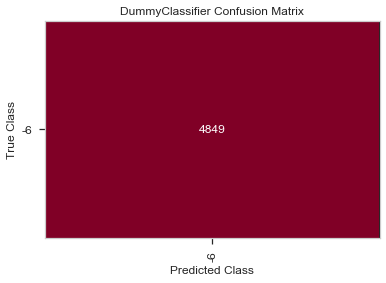

In [20]:
cm = ConfusionMatrix(dummy0);
cm.score(X_test, y_test);
cm.poof();

In [21]:
X = sm.add_constant(X)
model = sm.OLS(y,X)
results = model.fit()
results.summary()

NameError: name 'sm' is not defined

In [ ]:
clf = LogisticRegression(random_state=42).fit(X_train, y_train)
clf.predict(X_test)
clf.predict_proba(X_test)
clf.score(X_test, y_test)

In [ ]:
cm = ConfusionMatrix(clf);
cm.score(X_test, y_test);
cm.poof();

In [ ]:
#  generates predictions by respecting the training set's class distribution
dummy1 = DummyClassifier(strategy='stratified', random_state=42).fit(X_train, y_train)
dummy1.fit(X_train, y_train)
dummy1.score(X_test, y_test)

In [ ]:
cm = ConfusionMatrix(dummy1);
cm.score(X_test, y_test);
cm.poof();

In [ ]:
y_pred=clf.predict(X_test)
print(classification_report(y_test, y_pred))